# <h1><center>Credit Card Fraud Detection<center><h1>

# About the Dataset

`Context`
- Credit card companies can combat or remedy frauds by recognizing fraudulent credit card transactions, such that refunds to victim customers can be arranged.                                                            

`Content`
- The dataset includes credit card transactions made by European cardholders during September 2013. It covers transactions from two days, with 492 fraud cases out of 284,807 total transactions. This dataset is significantly imbalanced, with the fraudulent cases making up only 0.172% of all transactions.
- This dataset has been processed by Principal Component Analysis (PCA) transformation before being made available on Kaggle for download.
- According to the data provider(s), unprocessed information is not available for disclosure due to confidentiality issues.

`Datadict`
- Features V1 through V28 represent the main components derived through PCA. The only features not subjected to PCA transformation are `Time` and `Amount`.
- The 'Time' feature indicates the seconds elapsed between each transaction and the first one in the dataset.
- `Amount` refers to the transaction amount, and it could be useful for methods like example-dependent cost-sensitive learning.
- The `Class` feature serves as the response variable, taking a value of 1 for fraud cases and 0 otherwise.
- Due to the imbalance in class distribution, it is recommended to assess accuracy using the Area Under the Precision-Recall Curve (AUPRC), as the accuracy from a confusion matrix is not informative for unbalanced classification.

# Background Work

## Configure environment

In [1]:
### This cell may be skipped if this notebook is run locally ###

# Unconfigured Google Colab with throw following error:
# The reason of the error is that OpenCL drivers for NVIDIA are not present by default

# LightGBMError                             Traceback (most recent call last)
# <ipython-input-18-117627fea0b1> in <cell line: 17>()
#      27     X_train, y_train = X.iloc[list(train_idx), :], y.iloc[list(train_idx)]
#      28     X_test, y_test = X.iloc[list(test_idx), :], y.iloc[list(test_idx)]
# ---> 29     pipeline_model_lgbm.fit( X_train, y_train,
#      30                              #estimator__eval_metric="auc",
#      31                              #estimator__eval_set = [(X_test, y_test)],

# 5 frames
# /usr/local/lib/python3.10/dist-packages/lightgbm/basic.py in _safe_call(ret)
#     240     """
#     241     if ret != 0:
# --> 242         raise LightGBMError(_LIB.LGBM_GetLastError().decode('utf-8'))
#     243
#     244
# LightGBMError: No OpenCL device found


# Solution:
# https://github.com/microsoft/LightGBM/issues/5914#issuecomment-1713129547

# Edit -> Notebook settings -> T4GPU

!mkdir -p /etc/OpenCL/vendors && echo "libnvidia-opencl.so.1" > /etc/OpenCL/vendors/nvidia.icd
import lightgbm as lgb
from sklearn.datasets import make_regression

# Test case to see whether OpenCL device can be used
# X, y = make_regression(n_samples=10_000)
# dtrain = lgb.Dataset(X, label=y)
# bst = lgb.train(
#     params={
#         "objective": "regression",
#         "device": "gpu",
#         "verbose": 1
#     },
#     train_set=dtrain,
#     num_boost_round=5
# )

In [5]:
# Google Colab has some libraries come in default
# install libraries that do not come in default
!pip install colorama

# for manupilating data
import pandas  as pd
import numpy as np
import scipy.stats
import statsmodels.api as sm

# for visualizations
import matplotlib.pyplot as plt
import seaborn as sns
from colorama import Fore
sns.set_style("darkgrid")

pd.set_option("display.max_columns", None)
pd.set_option("display.max_colwidth", None)

## Remove warnings

In [3]:
import warnings
warnings.simplefilter(action='ignore')

# Look at the Dataset


## Import the dataset

In [7]:
### This cell may be skipped if this notebook is run locally ###

from google.colab import userdata
import os

os.environ["KAGGLE_KEY"] = userdata.get('KAGGLE_KEY')
os.environ["KAGGLE_USERNAME"] = userdata.get('KAGGLE_USERNAME')
! kaggle datasets download -d mlg-ulb/creditcardfraud/ --force # --force to redownload every time
! unzip "creditcardfraud.zip"

 88% 58.0M/66.0M [00:00<00:00, 93.8MB/s]
100% 66.0M/66.0M [00:00<00:00, 94.0MB/s]
Archive:  creditcardfraud.zip
  inflating: creditcard.csv          


In [ ]:
# check whether data has been downloaded
# !ls
# !ls /content

creditcard.csv	creditcardfraud.zip  sample_data


## Reading columns

Summary of findings about columns:
- Number of Rows is :  `284807`
- Number of columns is :  `31`
- Most columns are scaled, except `Time` and `Amount`
- Extreme values in `Time` and `Amount` columns are too extreme for other columns, which will be scaled later
- There are not-null values in the data
- There are `1081` complete duplicate
- There are `2` column is int64 and `29` float64
- The all values in data are `numeric`
- we have `492` frauds out of 284,807 transactions.




In [8]:
df = pd.read_csv('/content/creditcard.csv')
df.tail(10)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
284797,172782.0,-0.241923,0.712247,0.399806,-0.463406,0.244531,-1.343668,0.929369,-0.206210,0.106234,-0.284708,-0.612982,-0.066655,-0.732987,0.237948,-0.293959,-0.245496,-0.174846,-0.891169,-0.290491,-0.139512,-0.228876,-0.514376,0.279598,0.371441,-0.559238,0.113144,0.131507,0.081265,5.49,0
284798,172782.0,0.219529,0.881246,-0.635891,0.960928,-0.152971,-1.014307,0.427126,0.121340,-0.285670,-0.111640,-1.109232,-0.453235,-1.046946,1.122674,1.243518,-1.431897,0.939328,-0.002373,2.894952,0.006666,0.099936,0.337120,0.251791,0.057688,-1.508368,0.144023,0.181205,0.215243,24.05,0
284799,172783.0,-1.775135,-0.004235,1.189786,0.331096,1.196063,5.519980,-1.518185,2.080825,1.159498,-0.594242,-1.264072,0.453596,-0.243142,-0.858719,-0.766554,-0.644646,0.447184,0.388721,0.792135,0.348176,0.103302,0.654850,-0.348929,0.745323,0.704545,-0.127579,0.454379,0.130308,79.99,0
284800,172784.0,2.039560,-0.175233,-1.196825,0.234580,-0.008713,-0.726571,0.017050,-0.118228,0.435402,0.267772,0.523316,0.559047,-0.834660,0.626211,-0.541494,0.225361,-0.605252,-0.163049,0.561695,-0.256922,-0.268048,-0.717211,0.297930,-0.359769,-0.315610,0.201114,-0.080826,-0.075071,2.68,0
284801,172785.0,0.120316,0.931005,-0.546012,-0.745097,1.130314,-0.235973,0.812722,0.115093,-0.204064,-0.657422,0.644837,0.190916,-0.546329,-0.731707,-0.808036,0.599628,0.070441,0.373110,0.128904,0.000676,-0.314205,-0.808520,0.050343,0.102800,-0.435870,0.124079,0.217940,0.068803,2.69,0
284802,172786.0,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,4.356170,-1.593105,2.711941,-0.689256,4.626942,-0.924459,1.107641,1.991691,0.510632,-0.682920,1.475829,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0
284803,172787.0,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,-0.975926,-0.150189,0.915802,1.214756,-0.675143,1.164931,-0.711757,-0.025693,-1.221179,-1.545556,0.059616,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0
284804,172788.0,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,-0.484782,0.411614,0.063119,-0.183699,-0.510602,1.329284,0.140716,0.313502,0.395652,-0.577252,0.001396,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0
284805,172788.0,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,-0.399126,-1.933849,-0.962886,-1.042082,0.449624,1.962563,-0.608577,0.509928,1.113981,2.897849,0.127434,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0
284806,172792.0,-0.533413,-0.189733,0.703337,-0.506271,-0.012546,-0.649617,1.577006,-0.414650,0.486180,-0.915427,-1.040458,-0.031513,-0.188093,-0.084316,0.041333,-0.302620,-0.660377,0.167430,-0.256117,0.382948,0.261057,0.643078,0.376777,0.008797,-0.473649,-0.818267,-0.002415,0.013649,217.00,0


In [ ]:
df.shape

(284807, 31)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [ ]:
df.isna().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [ ]:
df.duplicated().sum()

1081

In [ ]:
# show the duplicated rows

duplicated = df.duplicated()
df_duplicated = df[duplicated]
df_duplicated

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
33,26.0,-0.529912,0.873892,1.347247,0.145457,0.414209,0.100223,0.711206,0.176066,-0.286717,-0.484688,0.872490,0.851636,-0.571745,0.100974,-1.519772,-0.284376,-0.310524,-0.404248,-0.823374,-0.290348,0.046949,0.208105,-0.185548,0.001031,0.098816,-0.552904,-0.073288,0.023307,6.14,0
35,26.0,-0.535388,0.865268,1.351076,0.147575,0.433680,0.086983,0.693039,0.179742,-0.285642,-0.482474,0.871800,0.853447,-0.571822,0.102252,-1.519991,-0.285912,-0.309633,-0.403902,-0.823743,-0.283264,0.049526,0.206537,-0.187108,0.000753,0.098117,-0.553471,-0.078306,0.025427,1.77,0
113,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
114,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
115,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282987,171288.0,1.912550,-0.455240,-1.750654,0.454324,2.089130,4.160019,-0.881302,1.081750,1.022928,0.005356,-0.541998,0.745036,-0.375165,-0.068227,-0.795939,-0.497901,-0.134224,-1.004958,0.086074,-0.207620,-0.524067,-1.337510,0.473943,0.616683,-0.283548,-1.084843,0.073133,-0.036020,11.99,0
283483,171627.0,-1.464380,1.368119,0.815992,-0.601282,-0.689115,-0.487154,-0.303778,0.884953,0.054065,-0.828015,-1.192581,0.944989,1.372532,-0.036493,-0.208747,0.320086,-0.204910,-0.024821,-0.468859,0.031950,0.287217,0.947825,-0.218773,0.082926,0.044127,0.639270,0.213565,0.119251,6.82,0
283485,171627.0,-1.457978,1.378203,0.811515,-0.603760,-0.711883,-0.471672,-0.282535,0.880654,0.052808,-0.830603,-1.191774,0.942870,1.372621,-0.037988,-0.208490,0.321883,-0.205951,-0.025225,-0.468427,0.023667,0.284205,0.949659,-0.216949,0.083250,0.044944,0.639933,0.219432,0.116772,11.93,0
284191,172233.0,-2.667936,3.160505,-3.355984,1.007845,-0.377397,-0.109730,-0.667233,2.309700,-1.639306,-1.449823,-0.508930,0.600035,-0.627313,1.017499,-0.887384,0.420096,1.856497,1.315099,1.096112,-0.821707,0.391483,0.266536,-0.079853,-0.096395,0.086719,-0.451128,-1.183743,-0.222200,55.66,0


In [ ]:
df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.168375e-15,3.416908e-16,-1.379537e-15,2.074095e-15,9.604066e-16,1.487313e-15,-5.556467e-16,1.213481e-16,-2.406331e-15,2.239053e-15,1.673327e-15,-1.247012e-15,8.190001e-16,1.207294e-15,4.887456e-15,1.437716e-15,-3.772171e-16,9.564149e-16,1.039917e-15,6.406204e-16,1.654067e-16,-3.568593e-16,2.578648e-16,4.473266e-15,5.340915e-16,1.683437e-15,-3.660091e-16,-1.227390e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,1.088850e+00,1.020713e+00,9.992014e-01,9.952742e-01,9.585956e-01,9.153160e-01,8.762529e-01,8.493371e-01,8.381762e-01,8.140405e-01,7.709250e-01,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,-2.458826e+01,-4.797473e+00,-1.868371e+01,-5.791881e+00,-1.921433e+01,-4.498945e+00,-1.412985e+01,-2.516280e+01,-9.498746e+00,-7.213527e+00,-5.449772e+01,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,-5.354257e-01,-7.624942e-01,-4.055715e-01,-6.485393e-01,-4.255740e-01,-5.828843e-01,-4.680368e-01,-4.837483e-01,-4.988498e-01,-4.562989e-01,-2.117214e-01,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,-9.291738e-02,-3.275735e-02,1.400326e-01,-1.356806e-02,5.060132e-02,4.807155e-02,6.641332e-02,-6.567575e-02,-3.636312e-03,3.734823e-03,-6.248109e-02,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,4.539234e-01,7.395934e-01,6.182380e-01,6.625050e-01,4.931498e-01,6.488208e-01,5.232963e-01,3.996750e-01,5.008067e-01,4.589494e-01,1.330408e-01,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,2.374514e+01,1.201891e+01,7.848392e+00,7.126883e+00,1.052677e+01,8.877742e+00,1.731511e+01,9.253526e+00,5.041069e+00,5.591971e+00,3.942090e+01,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


In [ ]:
print('The minimum and maximum values of each column:')
for item in df.columns:
  print(item, 'min=', df[item].min(), 'max=', df[item].max())

The minimum and maximum values of each column:
Time min= 0.0 max= 172792.0
V1 min= -56.407509631329 max= 2.45492999121121
V2 min= -72.7157275629303 max= 22.0577289904909
V3 min= -48.3255893623954 max= 9.38255843282114
V4 min= -5.68317119816995 max= 16.8753440335975
V5 min= -113.743306711146 max= 34.8016658766686
V6 min= -26.1605059358433 max= 73.3016255459646
V7 min= -43.5572415712451 max= 120.589493945238
V8 min= -73.2167184552674 max= 20.0072083651213
V9 min= -13.4340663182301 max= 15.5949946071278
V10 min= -24.5882624372475 max= 23.7451361206545
V11 min= -4.79747346479757 max= 12.0189131816199
V12 min= -18.6837146333443 max= 7.8483920756446
V13 min= -5.79188120632084 max= 7.12688295859376
V14 min= -19.2143254902614 max= 10.5267660517847
V15 min= -4.49894467676621 max= 8.87774159774277
V16 min= -14.1298545174931 max= 17.3151115176278
V17 min= -25.1627993693248 max= 9.25352625047285
V18 min= -9.49874592104677 max= 5.04106918541184
V19 min= -7.21352743017759 max= 5.59197142733558
V20 m

## Data cleaning

In [9]:
# drop duplicate values
df = df.drop_duplicates()
print(Fore.BLUE + f"the number of fraud = {(df['Class']==1).sum()} after dropping duplicated rows")

the number of fraud = 473 after dropping duplicated rows


## Splitting `fraud` & `normal`

In [10]:
# split dataset into fraud and normal for visualization
fraud = df[df['Class']==1]
normal = df[df['Class']==0]

In [ ]:
# print(fraud.shape,normal.shape)

(473, 31) (283253, 31)


In [ ]:
# show descriptive statistical information of normal transactions
fraud.Amount.describe()

count     473.000000
mean      123.871860
std       260.211041
min         0.000000
25%         1.000000
50%         9.820000
75%       105.890000
max      2125.870000
Name: Amount, dtype: float64

In [ ]:
# show descriptive statistical information of fraud transactions
# fraud transactions have fewer counts, higher means and different quantiles
normal.Amount.describe()

count    284315.000000
mean         88.291022
std         250.105092
min           0.000000
25%           5.650000
50%          22.000000
75%          77.050000
max       25691.160000
Name: Amount, dtype: float64

In [ ]:
# calculate ratio of fraud : normal transactions in the dataset
outlier_fraction = len(fraud)/float(len(normal))

In [ ]:
# the low fraud: normal ratio suggests that
# fraud transactions themselves are outliers in the dataset
# they are "few and distinct"
# this follows the assumption of model of classification to be used later
print(outlier_fraction)
print("Fraud Cases : {}".format(len(fraud)))
print("Valid Cases : {}".format(len(normal)))

0.0016698852262818046
Fraud Cases : 473
Valid Cases : 283253


## Plots of columns

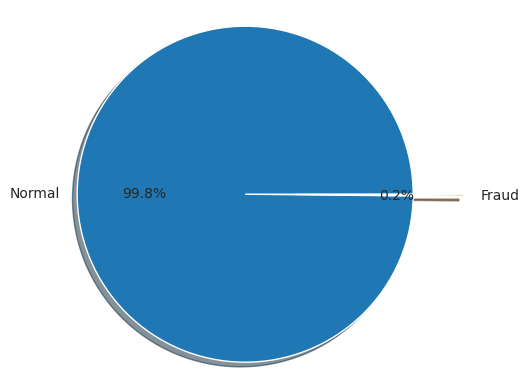

In [ ]:
# Pie plot of normal : fraud entries
plt.pie([(df['Class']==0).sum() , (df['Class']==1).sum()], labels=('Normal' , 'Fraud'), explode= [0,.3], autopct= '%1.1f%%', shadow= True)
plt.axis('equal')
plt.show()

In [ ]:
# Configure default font sizes for regular formatting
plt.rc('font', size=14)
plt.rc('axes', labelsize=14, titlesize=18)
plt.rc('legend', fontsize=14)
plt.rc('xtick', labelsize=12)
plt.rc('ytick', labelsize=12)

In [ ]:
# pair plot

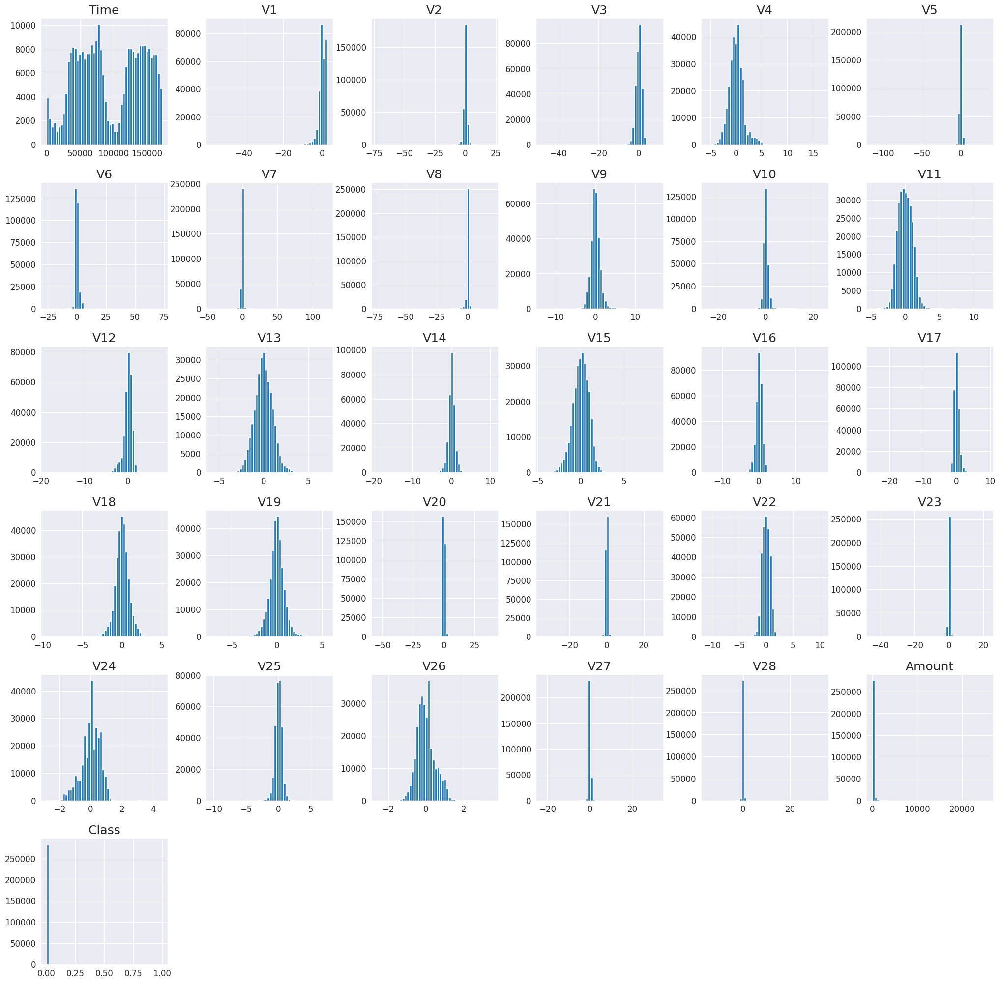

In [ ]:
# Histograms of all features to observe shape of distribution
# by naked-eye inspection
df.hist(bins=50, figsize=(25, 25) , grid = True)
plt.show()

- The above visualizations show that all features except `Time` and `Amount` appear to be relatively normal.
- Given relatively normal distribution, Gaussian Mixture Model (GMM) could be applied without performing rotation.
- `Time` and `Amount`, the two relatively unnormal features, will be scaled later on.

## Plots of fraud & normal

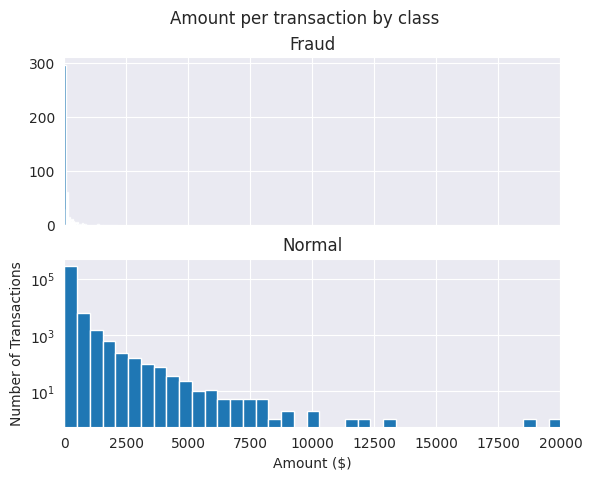

In [ ]:
# Histograms of fraud and normal transactions
f, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
f.suptitle('Amount per transaction by class')
bins = 50
ax1.hist(fraud.Amount, bins = bins)
ax1.set_title('Fraud')
ax2.hist(normal.Amount, bins = bins)
ax2.set_title('Normal')
plt.xlabel('Amount ($)')
plt.ylabel('Number of Transactions')
plt.xlim((0, 20000))
plt.yscale('log')
plt.show();

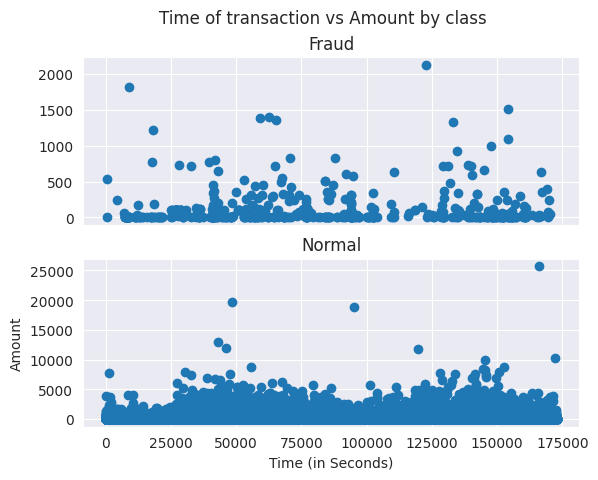

In [ ]:
# Scatter plots of fraud and normal transactions
# Fraud transactions seem distributed across time-axis
# throughout the dataset
f, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
f.suptitle('Time of transaction vs Amount by class')
ax1.scatter(fraud.Time, fraud.Amount)
ax1.set_title('Fraud')
ax2.scatter(normal.Time, normal.Amount)
ax2.set_title('Normal')
plt.xlabel('Time (in Seconds)')
plt.ylabel('Amount')
plt.show()

## Plots of normality

In [ ]:
# df.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

[]

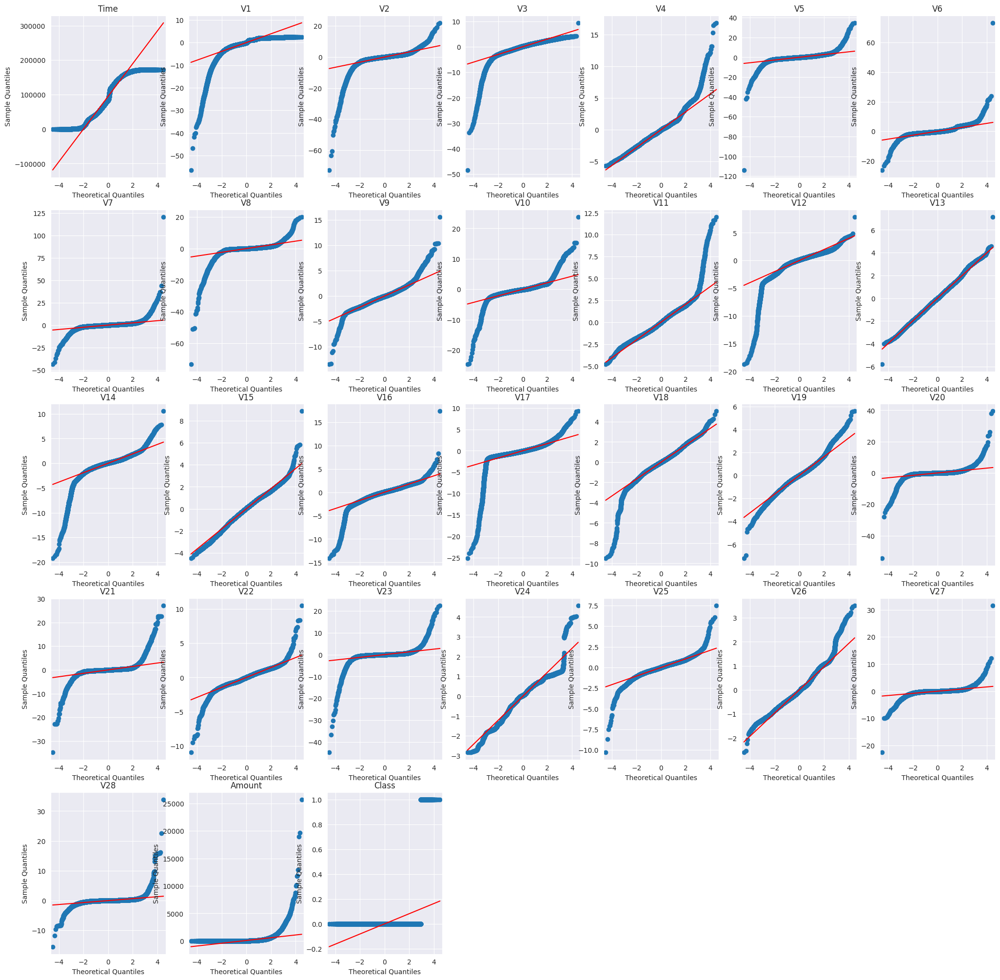

In [17]:
# Draw grid to contain subplots
total_len = len(df.columns)
w = int(np.sqrt(total_len))
b = total_len // w

if w * b < total_len:
  b += 1

plt.figure(figsize=(25, 25))

# Draw subplot of every column
for idx, item in enumerate(df.columns):
  ax = plt.subplot(w, b, idx + 1)
  sm.qqplot(df[item], line='s', ax=ax)
  plt.title(f"{item}")


plt.plot()

# most QQ plots at least showing a segment in the middle where Q3 and Q1 of
# different datapoints have roughly the same Q3 / Q1 ratio i.e. a linear gradient
# PCA processed columns not too sparsely distributed, except time and scale

## Plots of `Time`, `Amount` and `Class`

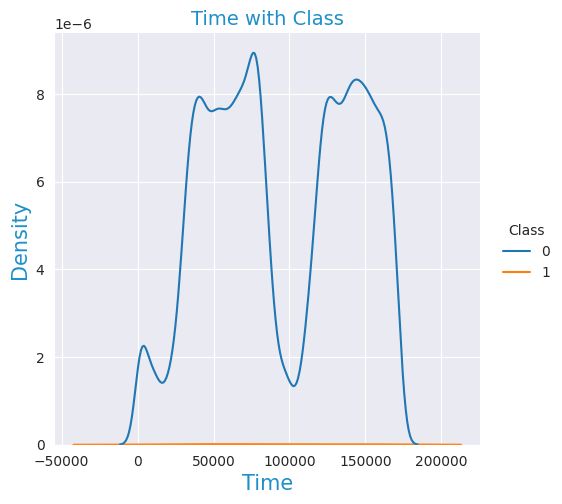

In [16]:
sns.displot(data=df, x="Time", kind="kde", hue="Class")

plt.rc('ytick', labelsize=10)
plt.ylabel('Density' , size=15, color='#1e90c9')
plt.xlabel('Time' , size=15, color='#1e90c9')
plt.title('Time with Class' , size = 14 , color='#1e90c9')

plt.show()

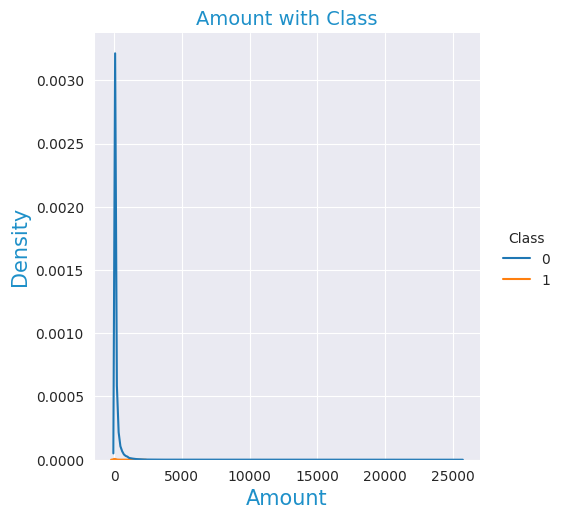

In [ ]:
sns.displot(data=df, x="Amount", kind="kde", hue="Class")

plt.rc('ytick', labelsize=10)
plt.ylabel('Density' , size=15, color='#1e90c9')
plt.xlabel('Amount' , size=15, color='#1e90c9')
plt.title('Amount with Class' , size = 14 , color='#1e90c9')

plt.show()

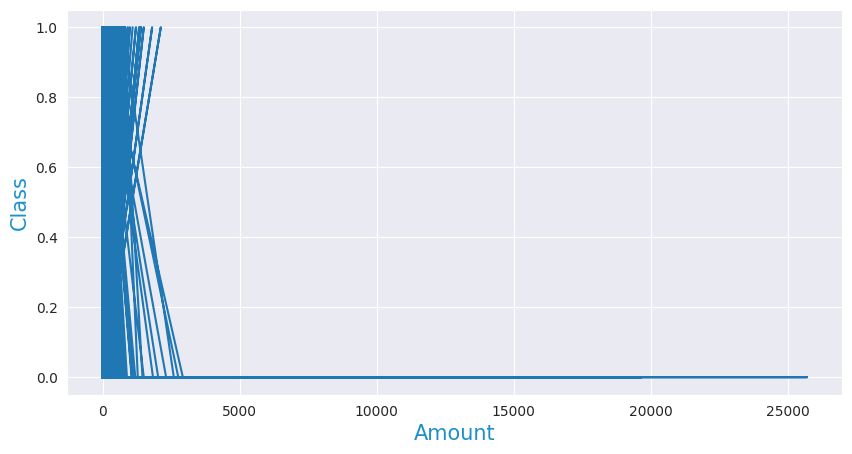

In [ ]:
plt.figure(figsize = (10,5))
plt.xlabel('Amount' , size = 15,color='#1e90c9')
plt.ylabel('Class' , size = 15,color='#1e90c9')

plt.plot(df['Amount'] , df['Class'])
plt.show()

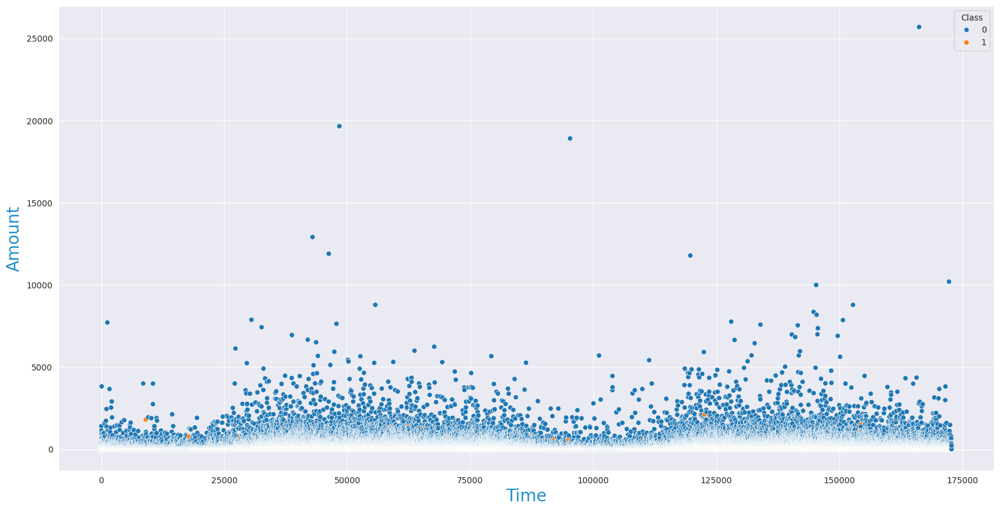

In [ ]:
plt.figure(figsize = (20,10))
plt.rc('xtick', labelsize=10)
plt.rc('ytick', labelsize=10)
plt.xlabel('Time' , size = 20,color='#1e90c9')
plt.ylabel('Amount' , size = 20,color='#1e90c9')

sns.scatterplot(data = df , x = 'Time' , y = 'Amount' , hue = 'Class')
plt.show()

As shown in the above visualization, there is no segment of Time or Amount where Fraud is more likely to happen. Fraud is distributed over the whole dataset.


## Correlations & significance

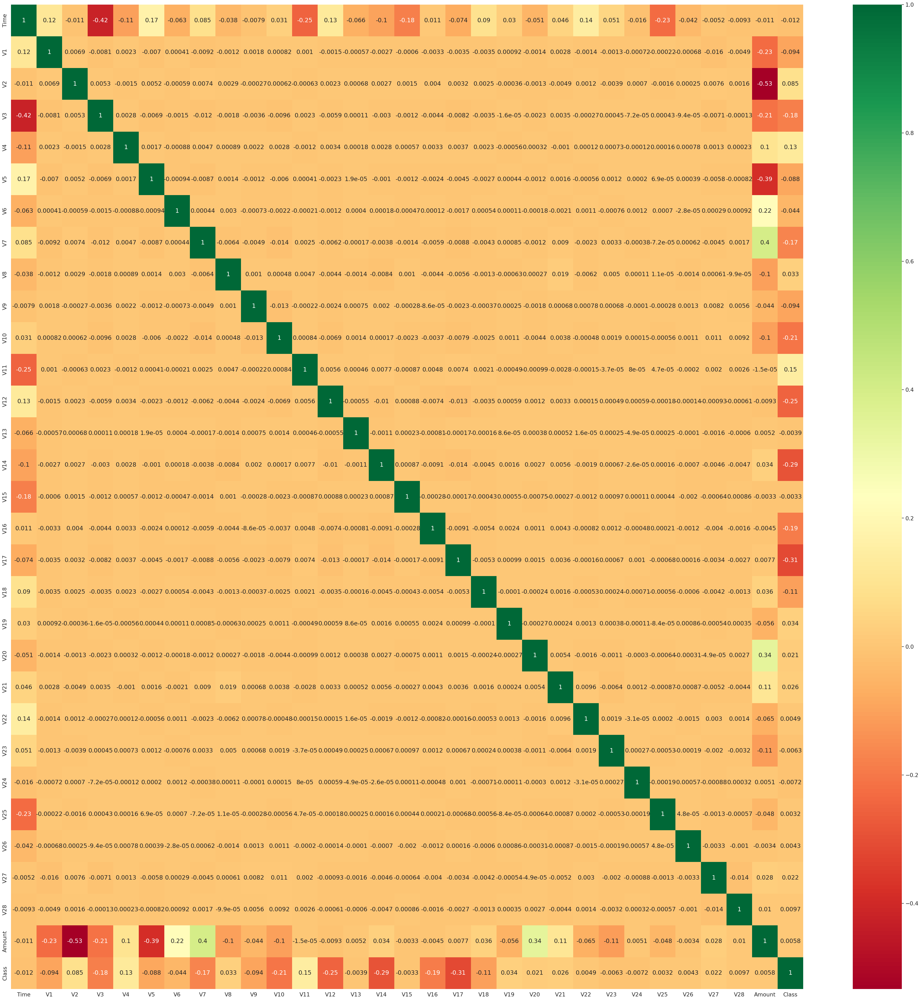

In [19]:
# plot correlation map of each feature pair
corrmat = df.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(50,50))

# plot heat map
sns.set(font_scale=1.4)
g = sns.heatmap(df[top_corr_features].corr(),annot=True,cmap="RdYlGn")

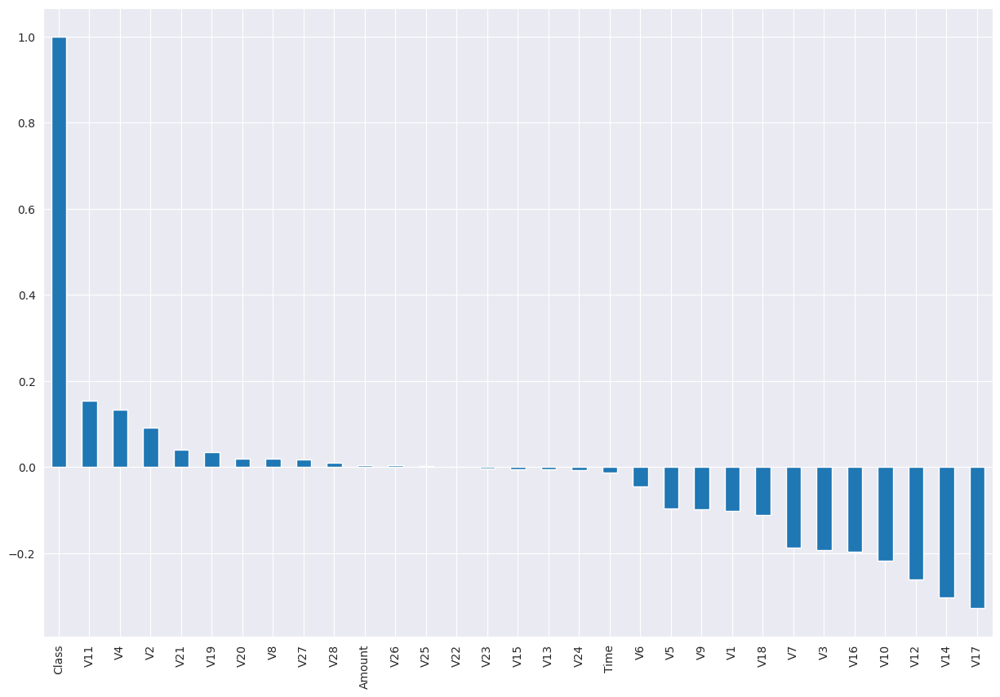

In [ ]:
# plot correlation of `class` in respect of all columns
df_correlation = df.corr()

plt.figure(figsize = (15,10))
plt.rc('xtick', labelsize=10)
plt.rc('ytick', labelsize=10)
df_correlation['Class'].sort_values(ascending = False).plot(kind = 'bar')
plt.show()

- *Negative Correlations:* `V17`, `V14`, `V12` and `V10` are negatively correlated to `Class`
- *Positive Correlations:* `V2`, `V4`, `V11` and `V19` are positively correlated to `Class`

In [ ]:
scipy.stats.pearsonr(df['Class'], df['Time'])[1]

4.8182688917963506e-11

In [ ]:
# all correlation with Class is statistically significant except V22, V23 and V25
print('Are correlations between columns are statistically significant?')
for item in df.columns:
  pvalue = scipy.stats.pearsonr(df['Class'], df[item])[1]
  Trigger = True if pvalue < 0.05 else False
  print(item, 'pvalue=', pvalue, Trigger)

Are correlations between columns are statistically significant?
Time pvalue= 4.8182688917963506e-11 True
V1 pvalue= 0.0 True
V2 pvalue= 0.0 True
V3 pvalue= 0.0 True
V4 pvalue= 0.0 True
V5 pvalue= 0.0 True
V6 pvalue= 4.213111345326176e-120 True
V7 pvalue= 0.0 True
V8 pvalue= 2.7406731012492527e-26 True
V9 pvalue= 0.0 True
V10 pvalue= 0.0 True
V11 pvalue= 0.0 True
V12 pvalue= 0.0 True
V13 pvalue= 0.014737338961000997 True
V14 pvalue= 0.0 True
V15 pvalue= 0.024201426001455077 True
V16 pvalue= 0.0 True
V17 pvalue= 0.0 True
V18 pvalue= 0.0 True
V19 pvalue= 5.801517302140792e-77 True
V20 pvalue= 7.964292023523612e-27 True
V21 pvalue= 3.002268557850843e-103 True
V22 pvalue= 0.667359691392515 False
V23 pvalue= 0.15186019852141144 False
V24 pvalue= 0.00011637602808849718 True
V25 pvalue= 0.0775250093813989 False
V26 pvalue= 0.017419705371244553 True
V27 pvalue= 6.441920343674859e-21 True
V28 pvalue= 3.5953535619905914e-07 True
Amount pvalue= 0.002651220649191581 True
Class pvalue= 0.0 True


## Plots of PCA projected coordinates

In [21]:
# visualization of PCA
from sklearn.decomposition import PCA

# `Time` `Amount` and `Class` are dropped because they are plotted above

# project columns except `Time` `Amount` and `Class` to 3D coodinates
pca = PCA(n_components=3)
X3D = pca.fit_transform(df.drop(['Time', 'Amount','Class'] , axis = 1))

# project columns except `Time` `Amount` and `Class` to 2D coodinates
pca = PCA(n_components=2)
X2D = pca.fit_transform(df.drop(['Time', 'Amount','Class'] , axis = 1))


In [35]:
import plotly.express as px

# color points in plot with `Class`
fig = px.scatter_3d(X3D,x=0,y=1,z=2,
                    color = df['Class'],
                    title='3D Plot of PCA Projected Coordinates of\n Columns except `Time` `Amount` `Class` \nshowing fraud and normal datapoints')
fig.show()

# it shows a pattern of fraud even in the absence of `Time` `Amount` and `Class` in projection

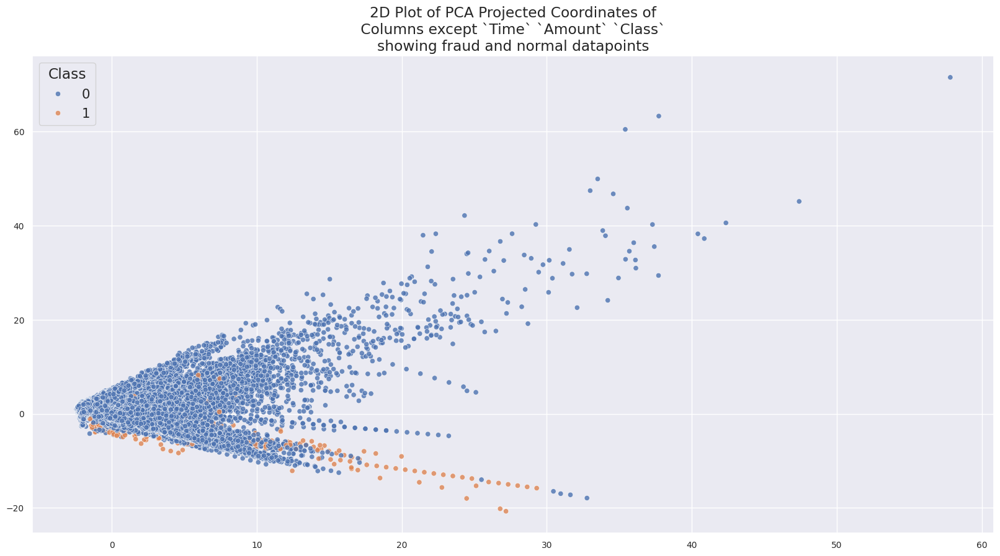

In [28]:
plt.figure(figsize = (20,10))
plt.title('2D Plot of PCA Projected Coordinates of\n Columns except `Time` `Amount` `Class` \nshowing fraud and normal datapoints')

sns.scatterplot(x = X2D[:,0] , y = X2D[:,1] , hue =df['Class'] , alpha = .8 )
plt.show()

# it shows a pattern of fraud even in the absence of `Time` `Amount` and `Class` in the projection

## Scaling

In [ ]:
# Most columns have already been scaled
# Scale `Amount` and `Time` columns which are not scaled yet

from sklearn.preprocessing import StandardScaler, RobustScaler

# RobustScaler is less prone to outliers , scaled feature= feature−median / IQR.
rob_scaler = RobustScaler()

df['scaled_amount'] = rob_scaler.fit_transform(df['Amount'].values.reshape(-1,1))
df['scaled_time'] = rob_scaler.fit_transform(df['Time'].values.reshape(-1,1))

df.drop(['Time','Amount'], axis=1, inplace=True)


In [ ]:
scaled_amount = df['scaled_amount']
scaled_time = df['scaled_time']

df.drop(['scaled_amount', 'scaled_time'], axis=1, inplace=True)
df.insert(0, 'scaled_amount', scaled_amount)
df.insert(1, 'scaled_time', scaled_time)

df.head()

,scaled_amount,scaled_time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Class
0,1.774718,-0.995290,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,0
1,-0.268530,-0.995290,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,0
2,4.959811,-0.995279,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,0
3,1.411487,-0.995279,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,0
4,0.667362,-0.995267,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,0


# Modeling

## Summary of Isolation Forest

**Introduction**

Isolation Forest is a machine learning method developed by Fei Tony Liu and Zhi-Hua Zhou and others in 2008 to detect outliers within datasets. This technique uses binary trees to identify anomalies, resulting in a linear time complexity and low memory usage, making it effective for handling large volumes of data.

Since its inception, Isolation Forest has become widely recognized as an algorithm for detecting anomalies across various domains including cybersecurity, finance, and medical research.

Isolation Forests are constructed using decision trees. This model does not rely on predefined labels and operates as an unsupervised learning.

The method of Isolation Forest is built on a assumption that anomalies within data are often characterized by being "few and different", compared to the majority of the dataset.

**Mechanism**

The mechanism of Isolation Forests is an ensemble of binary decision trees. Each individual tree within an Isolation Forest is referred to as an Isolation Tree (iTree).

In an Isolation Forest, all data is randomly sampled and processed through a forest of iTree utilizing randomly chosen features. The algorithm initiates by training the data, creating these Isolation Trees. Data points that traverse deeper into the tree structure are less likely to be considered anomalies because they require more splits to isolate them. Conversely, samples traversing shorter branches suggest anomalies, and those samples are easier for the tree to separate from the rest of the dataset.

**Training Stage**

The training stage can be described as follows:
1. A random subset of the data is chosen and allocated to a binary tree, an iTree.
2. The iTree begins branching by first randomly selecting a feature from the total set of N features.
3. Subsequent branching occurs based on a randomly chosen threshold within the range of minimum and maximum values of the selected feature.
4. If a data point's value is lower than the chosen threshold, it moves to the left branch; otherwise, it goes to the right. This action splits a node into left and right branches.
5. Step 2 to 5 repeats by recursive iteration until each data point is entirely isolated or until the maximum depth (if specified) is reached.
6. The above steps are repeated to create multiple random iTrees.

**Scoring Stage**

During the scoring phase, a data point passes through all the previously trained iTrees. An anomaly score is assigned to each data point by the depth it traverses in the tree structure. This score is a compilation of all depth of traversion obtained from each iTree. Usually, an anomaly score of -1 is assigned for anomalies, while 1 is assigned to normalities, depending on the contamination parameter provided, which represents the percentage of anomalies present in the data.


## Import libraries

In [38]:
# general modeling tools
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

# tools for Isolation Forest
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import GridSearchCV

# metrics
from sklearn import metrics
from sklearn.metrics import precision_score, make_scorer, recall_score, f1_score , confusion_matrix , classification_report , ConfusionMatrixDisplay ,roc_curve ,roc_auc_score , precision_recall_curve , auc

## Splitting training and testing data

In [39]:
# y = f(x)
# splitting the equation by = sign
# dropping `Class`, which is the correct result, in training and testing data
# because the model should learn about the pattern of fraud
# not memorizing points of fraud

x = df.drop('Class', axis=1)
y = df['Class']

In [40]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.1, shuffle=True , stratify=y, random_state=42)

# parameter, stratify=y
# ensure that the proportion of fraud case of `Class`
# in the training and testing sets are
# the same with the original df.

In [41]:
y_train # showing training dataset y

50340     0
231956    0
144562    0
91048     0
189620    0
         ..
3525      0
150598    0
242674    0
60594     0
67057     0
Name: Class, Length: 255353, dtype: int64

In [42]:
x_train # showing training dataset x

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
50340,44453.0,0.642632,-2.386717,0.220606,-1.041128,-1.953948,-0.302390,-0.596753,-0.145963,-1.786001,1.174708,-0.206851,-0.763995,0.538855,-0.247107,1.063998,-0.423841,0.719696,-0.441613,-0.732991,0.501536,-0.085624,-0.821965,-0.163091,0.036139,-0.098478,-0.425025,-0.020542,0.099838,435.70
231956,146992.0,-0.303349,1.077423,-0.439382,-0.474360,0.507029,-0.700396,0.925844,0.070086,-0.505994,-0.856738,-1.496819,0.425925,1.322264,0.475624,0.439027,-0.122893,-0.607455,0.352028,0.328494,-0.048732,0.434505,1.236417,-0.180111,-0.585031,-0.312352,-0.123843,0.084584,0.154410,49.73
144562,86218.0,-0.740971,0.728013,2.962252,-0.062982,-0.009021,0.006129,0.383069,-0.094311,-0.050369,-0.661958,-0.654424,0.484077,1.720061,-0.851865,0.921251,0.832676,-1.281674,0.601765,-1.087447,0.125604,0.254299,0.927449,-0.455751,0.078986,0.451672,-0.340382,-0.062657,-0.136544,12.00
91048,63293.0,1.525561,-0.916912,0.095089,-1.331110,-1.406128,-1.290635,-0.651940,-0.260966,-1.895885,1.483877,-0.630450,-1.620849,-1.118529,0.217022,0.529799,-0.498872,0.709699,-0.385529,0.043128,-0.424702,-0.579300,-1.430047,0.223568,0.281701,0.182369,-0.524147,-0.001712,0.017139,19.90
189620,128486.0,1.554678,-0.898056,-2.786752,-0.011206,0.379134,-1.736647,1.450043,-0.842845,-0.248726,-0.044147,-0.498069,0.776518,1.112869,0.616518,-0.236622,-0.808608,-0.019188,-1.055717,0.133886,0.522597,0.442690,0.797574,-0.442470,0.120845,0.401659,1.606878,-0.243493,-0.049385,327.04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3525,3013.0,-1.708940,-1.296255,1.953170,-2.277028,-0.510388,0.408807,0.329231,0.477331,1.058119,-2.015791,1.387879,0.817858,-0.936164,0.083064,0.682882,-0.592115,0.055833,0.095035,-0.304827,0.557379,0.466843,0.860939,0.361317,-0.264732,0.423478,0.065689,-0.026392,0.077562,261.80
150598,93731.0,-0.035645,-0.139387,0.339134,-1.494976,0.318468,-1.391005,0.276625,-0.329313,0.363875,-0.252764,-0.237631,-3.573246,0.878263,1.381142,-1.732693,0.570223,1.077579,-1.386931,0.485958,-0.023626,-0.003988,0.123015,0.161821,-0.033205,-0.998618,-0.551168,0.172633,0.234407,15.90
242674,151594.0,-0.875424,1.159992,0.573970,1.178888,-0.206267,0.260623,0.371124,0.443532,-0.011588,-0.192711,0.019586,0.876056,-0.908948,0.272981,-2.167267,-1.068312,0.500027,-0.136893,1.507298,-0.353885,-0.100597,-0.157726,0.049751,-0.014156,-0.513855,-0.771982,-0.242970,0.094879,37.00
60594,49395.0,1.247036,0.348595,0.589407,0.982998,-0.222000,-0.452687,-0.012336,-0.140168,0.052173,-0.069423,-0.586291,0.714493,1.314389,-0.028293,1.080076,0.465393,-0.794899,-0.170662,-0.188029,-0.042753,-0.211495,-0.556038,0.037106,-0.133330,0.403622,-0.595756,0.043911,0.032002,5.00


In [43]:
y_test # showing testing dataset y

73573     0
17063     0
202583    0
35306     0
106371    0
         ..
185720    0
5041      0
70698     0
241241    0
73206     0
Name: Class, Length: 28373, dtype: int64

In [44]:
x_test # showing testing dataset x

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
73573,55192.0,0.471727,-2.300052,0.506669,-0.382747,-1.727818,0.613011,-0.844659,0.264561,-0.227545,0.465962,0.890457,-0.344372,-0.788441,-0.202439,0.103628,1.289048,0.293138,-0.655799,0.385617,0.862693,0.610903,0.818683,-0.488846,-0.250407,0.205917,-0.056039,-0.025159,0.080567,435.50
17063,28405.0,0.769255,-0.404248,0.195493,1.617499,-0.474257,-0.543650,0.509890,-0.264398,0.129775,-0.213424,-0.603259,0.938144,0.844106,-0.093234,-0.417141,-0.442009,-0.062154,-0.593060,-0.086223,0.363751,0.018637,-0.217032,-0.303705,0.437461,0.684101,-0.369520,-0.013644,0.060992,236.00
202583,134402.0,-1.465044,-0.488380,0.592761,0.249526,1.952219,-1.828154,0.434310,-0.501925,-0.002225,0.109147,-0.773839,-0.778886,-1.265418,0.590100,1.281427,-0.774764,-0.092592,-0.212426,1.122141,-0.224586,-0.174905,-0.298246,-0.328938,-0.095344,-0.072753,-0.334887,-0.305436,0.156945,5.00
35306,38056.0,0.878566,-2.015811,0.122529,-1.275674,-1.720609,-0.376472,-0.652399,-0.119822,-2.084223,1.442745,0.976261,-0.308757,0.383858,-0.032752,0.039534,0.072489,0.118910,0.447167,0.160407,0.329048,-0.234663,-1.097757,-0.117679,-0.059296,0.011661,-0.509954,-0.029433,0.069413,329.80
106371,69942.0,-1.392209,0.222727,2.632855,1.327151,-0.978915,1.240565,-0.955077,0.991364,1.064801,-0.907000,-2.398685,0.486416,0.437099,-1.098548,-1.184970,-0.460721,0.402064,0.604367,1.239238,0.320565,0.144986,0.732187,-0.364510,-0.369979,0.646488,0.084198,0.290798,0.035213,59.35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
185720,126793.0,-0.761159,1.582995,-0.326112,-0.484623,1.748538,-0.775134,1.769148,-0.499158,-1.159898,-1.002552,-0.599185,0.169872,1.278634,-1.078814,-0.267087,-0.480517,0.779299,-0.108835,0.594547,0.072324,0.050969,0.228150,-0.740059,0.511671,1.186691,0.872753,-0.294345,0.034778,17.89
5041,4652.0,-1.289699,-0.959548,0.951773,-3.437411,-0.865271,-0.901859,-0.314266,0.318759,1.383224,-2.038790,1.624170,-0.812399,2.788383,1.502852,-0.942474,-1.998033,0.541559,2.347631,-0.129986,-0.164999,-0.233020,-0.316659,0.048693,-0.049049,0.492297,-0.939264,-0.084017,-0.156184,130.07
70698,53982.0,1.193905,0.622545,-0.388834,1.308873,0.204144,-0.791967,0.183192,-0.064078,0.019421,-0.703564,0.217211,-0.431144,-0.832789,-1.157941,1.424001,0.339224,1.215853,0.236021,-0.978765,-0.178052,-0.048768,-0.069325,-0.085021,-0.079936,0.592806,-0.295167,0.046806,0.052472,1.00
241241,150943.0,0.076899,0.843253,-0.145027,-0.235062,0.880312,-1.249226,1.287930,-0.483786,0.063791,-0.814344,-0.784153,-0.997817,-1.070709,-0.779348,0.825279,-0.011506,0.360109,0.883348,-0.023587,-0.026237,0.277198,1.020311,-0.248762,-0.196993,-0.515247,-0.179948,0.054135,0.019724,24.15


In [45]:
print("Training set anomalies:", sum(y_train == 1))
print("Testing set anomalies:", sum(y_test == 1))

Training set anomalies: 426
Testing set anomalies: 47


## Defining the model

In [48]:
iforest = IsolationForest(n_estimators = 500, contamination = .02 , random_state=42)
print(iforest.get_params()) # print model parameter

{'bootstrap': False, 'contamination': 0.02, 'max_features': 1.0, 'max_samples': 'auto', 'n_estimators': 500, 'n_jobs': None, 'random_state': 42, 'verbose': 0, 'warm_start': False}


In [49]:
iforest

IsolationForest(contamination=0.02, n_estimators=500, random_state=42)

## Fitting the model

In [50]:
# fitting the model to training data
iforest.fit(x_train)

IsolationForest(contamination=0.02, n_estimators=500, random_state=42)

In [51]:
# showing first 20 fitting results
print(iforest.fit(x_train)[:20])
# print("Number of outliers detected: {}".format(prediction[prediction < 0].sum()))
# print("Number of normal samples detected: {}".format(prediction[prediction > 0].sum()))

[ExtraTreeRegressor(max_depth=8, max_features=1, random_state=1952926171), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=1761383086), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=1449071958), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=1910541088), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=1341730541), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=1286572245), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=1005142668), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=502852014), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=186414760), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=1956263048), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=15592051), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=1628376228), ExtraTreeRegressor(max_depth=8, max_features=1, random_state=1638437331), ExtraTreeRegressor(max_depth=8, max_featu

## Predicting using the model

In [52]:
# apply fitted iforest model to x_test
y_pred = iforest.predict(x_test)

# Convert predictions to binary labels (-1 for outlier, 1 for inlier)
y_pred_binary = [1 if label == -1 else 0 for label in y_pred]

In [53]:
y_pred # prediction of x_test in form of an array

array([1, 1, 1, ..., 1, 1, 1])

## Scores of model

In [54]:
data = x_test.copy() # initialize empty dataframe
data['scores'] = iforest.decision_function(x_test)
data['anomaly_score'] = iforest.predict(x_test)
data['result'] = y_test
data.head(10)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,scores,anomaly_score,result
73573,55192.0,0.471727,-2.300052,0.506669,-0.382747,-1.727818,0.613011,-0.844659,0.264561,-0.227545,0.465962,0.890457,-0.344372,-0.788441,-0.202439,0.103628,1.289048,0.293138,-0.655799,0.385617,0.862693,0.610903,0.818683,-0.488846,-0.250407,0.205917,-0.056039,-0.025159,0.080567,435.50,0.125417,1,0
17063,28405.0,0.769255,-0.404248,0.195493,1.617499,-0.474257,-0.543650,0.509890,-0.264398,0.129775,-0.213424,-0.603259,0.938144,0.844106,-0.093234,-0.417141,-0.442009,-0.062154,-0.593060,-0.086223,0.363751,0.018637,-0.217032,-0.303705,0.437461,0.684101,-0.369520,-0.013644,0.060992,236.00,0.159922,1,0
202583,134402.0,-1.465044,-0.488380,0.592761,0.249526,1.952219,-1.828154,0.434310,-0.501925,-0.002225,0.109147,-0.773839,-0.778886,-1.265418,0.590100,1.281427,-0.774764,-0.092592,-0.212426,1.122141,-0.224586,-0.174905,-0.298246,-0.328938,-0.095344,-0.072753,-0.334887,-0.305436,0.156945,5.00,0.141022,1,0
35306,38056.0,0.878566,-2.015811,0.122529,-1.275674,-1.720609,-0.376472,-0.652399,-0.119822,-2.084223,1.442745,0.976261,-0.308757,0.383858,-0.032752,0.039534,0.072489,0.118910,0.447167,0.160407,0.329048,-0.234663,-1.097757,-0.117679,-0.059296,0.011661,-0.509954,-0.029433,0.069413,329.80,0.134883,1,0
106371,69942.0,-1.392209,0.222727,2.632855,1.327151,-0.978915,1.240565,-0.955077,0.991364,1.064801,-0.907000,-2.398685,0.486416,0.437099,-1.098548,-1.184970,-0.460721,0.402064,0.604367,1.239238,0.320565,0.144986,0.732187,-0.364510,-0.369979,0.646488,0.084198,0.290798,0.035213,59.35,0.118690,1,0
56447,47430.0,-0.641110,1.506487,1.935089,2.620384,0.229420,0.045051,0.311117,0.138437,-1.283148,-0.044824,0.305587,-0.417832,0.269724,-1.353373,1.461429,0.472180,1.042516,0.354662,-0.725675,0.047051,0.186630,0.543936,-0.190345,0.309899,-0.265022,0.175981,0.034616,0.149175,4.00,0.143559,1,0
147410,88519.0,-1.402301,-0.984616,1.877676,-3.402441,-1.537382,1.743650,0.500159,-0.193024,-1.153350,1.506830,0.109221,-0.369388,1.965897,-1.953453,-0.684290,0.667266,-1.015741,1.331809,-0.583105,0.200451,-0.243366,0.608254,-0.268098,-0.117179,0.690919,-0.068745,0.365911,-0.172761,300.00,0.090867,1,0
152932,97612.0,-0.138161,1.857610,-0.286939,2.887128,2.767210,1.457056,1.148124,0.184897,-0.590287,-0.495001,2.162146,-2.896324,1.248325,-1.090366,-1.777758,1.048550,2.236195,0.169081,-2.699346,-0.228009,-0.379374,-0.617304,0.099908,-2.013838,-1.363535,-0.482450,0.100212,0.057581,7.12,0.034725,1,0
252204,155696.0,-0.666873,-1.373693,2.015561,-2.306487,-1.418420,1.253906,-0.037069,-0.057040,-1.964769,0.750036,-1.343575,-1.235769,1.959733,-1.328935,1.361969,0.105307,-0.141024,1.171426,0.299279,0.646804,0.176468,0.613987,0.216792,-0.034592,0.341543,0.123379,-0.129592,-0.117974,272.65,0.106001,1,0
126995,78173.0,-0.458058,0.624041,1.106114,1.069328,0.679128,0.929725,0.636754,0.233290,-0.688596,-0.183140,0.348602,0.742745,0.302001,0.132265,-0.460757,-0.772323,0.043301,0.085883,1.356934,0.209605,0.055413,0.263738,-0.129016,-0.815753,-0.027901,-0.208133,0.160112,0.131019,65.00,0.162280,1,0


In [55]:
outlier = data[data['result'] == 1]
outlier.shape

(47, 33)

In [56]:
outlier.head(47)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,scores,anomaly_score,result
212644,138942.0,-2.356348,1.746360,-6.374624,1.772205,-3.439294,1.457811,-0.362577,1.443791,-1.927359,-6.564659,2.450752,-5.694074,-1.155469,-7.132151,-0.059628,-4.596577,-5.522088,-3.529066,-0.663371,0.194810,0.857942,0.621203,0.964817,-0.619437,-1.732613,0.108361,1.130828,0.415703,727.91,-0.080740,-1,1
215132,139951.0,-2.921944,-0.228062,-5.877289,2.201884,-1.935440,0.631141,-1.245106,1.511348,-1.899987,-6.428231,4.229154,-5.292314,-0.888087,-7.672250,0.547571,-4.307060,-5.701174,-1.772803,-0.193132,2.230735,1.441622,0.895528,1.385511,-2.028024,0.509131,0.172643,0.726781,0.234514,723.21,-0.096279,-1,1
163586,116067.0,0.949241,1.333519,-4.855402,1.835006,-1.053245,-2.562826,-2.286986,0.260906,-0.895366,-4.542612,2.453710,-4.925199,-1.200412,-6.424372,1.014897,-3.129421,-5.147039,-1.815437,0.520497,0.424608,0.306598,-0.854627,0.101177,-0.281497,0.024444,-0.107944,0.625289,0.315677,65.00,-0.009688,-1,1
107067,70270.0,-1.512516,1.133139,-1.601052,2.813401,-2.664503,-0.310371,-1.520895,0.852996,-1.496495,-4.056293,1.553756,-2.743551,1.504541,-5.428788,-0.016017,-3.727188,-3.946300,-1.680286,2.303613,1.249586,0.729828,0.485286,0.567005,0.323586,0.040871,0.825814,0.414482,0.267265,318.11,-0.020515,-1,1
122479,76575.0,-5.622469,3.480623,-6.200677,4.311234,-5.226286,-1.341764,-5.220941,2.682844,-2.921484,-6.561257,3.211264,-6.861661,0.326462,-7.755254,0.504652,-6.276617,-10.611715,-4.146774,2.197288,-0.156289,0.949569,-0.428986,-0.350676,0.197550,0.159234,-0.377791,-0.213562,0.459529,219.80,-0.111485,-1,1
248296,153875.0,-0.613696,3.698772,-5.534941,5.620486,1.649263,-2.335145,-0.907188,0.706362,-3.747646,-4.230984,4.436319,-4.503801,-0.954361,-9.861372,-0.505329,0.269282,0.591319,1.795992,-1.085208,0.354773,0.319261,-0.471379,-0.075890,-0.667909,-0.642848,0.070600,0.488410,0.292345,0.00,-0.026210,-1,1
240222,150494.0,1.852889,1.069593,-1.776101,4.617410,0.770413,-0.400859,-0.040970,0.089510,-0.217705,-0.373927,-0.688454,-1.463207,-1.624155,-4.252466,-1.340176,1.732873,2.934481,1.437197,-1.923309,-0.288392,-0.157869,-0.176244,0.027437,-0.468006,0.058063,0.148263,0.042278,0.040573,1.00,0.063611,1,1
150601,93742.0,-3.291125,4.401194,-8.394212,4.453580,-4.790055,-4.240182,-9.219001,1.974030,-2.912943,-13.540168,9.413040,-18.047597,-0.728187,-15.393045,0.349485,-13.303888,-21.297906,-7.262311,2.274226,1.490869,2.102343,0.597370,-0.328086,0.445752,0.585281,-0.399005,2.116004,1.050744,1.00,-0.152559,-1,1
6734,8451.0,0.314597,2.660670,-5.920037,4.522500,-2.315027,-2.278352,-4.684054,1.202270,-0.694696,-5.526278,6.662437,-8.525465,0.742745,-7.678668,0.593070,-4.478137,-5.844266,-1.102731,2.177386,0.562706,0.743314,0.064038,0.677842,0.083008,-1.911034,0.322188,0.620867,0.185030,1.00,-0.080619,-1,1
68633,53076.0,1.296231,0.417447,0.193963,0.901644,0.130531,-0.371634,0.158126,-0.202669,-0.079512,-0.045088,-0.876738,0.687488,1.574718,-0.007791,0.948316,0.377154,-0.868183,-0.067135,-0.064493,-0.029559,-0.112114,-0.220002,-0.121022,-0.440454,0.671540,-0.413518,0.032838,0.020600,1.18,0.169636,1,1


## Plot of scores

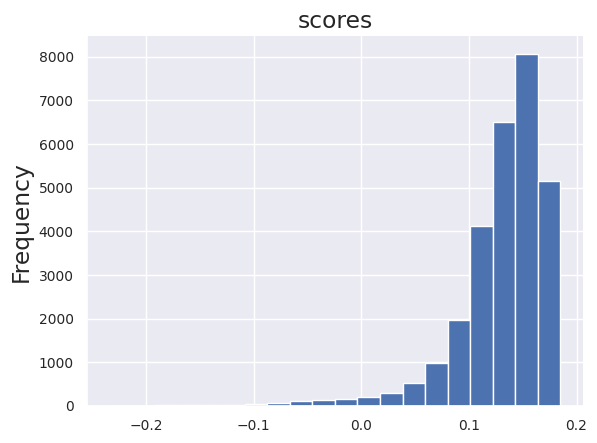

In [57]:
# scores
data['scores'].plot(kind='hist', bins=20, title='scores')
plt.gca().spines[['top', 'right',]].set_visible(False)

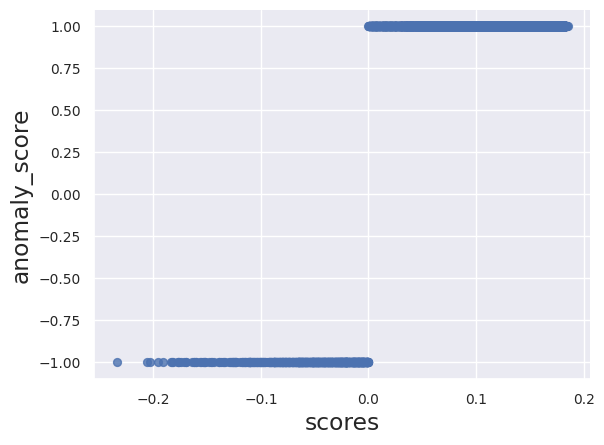

In [61]:
# scores vs anomaly_score
data.plot(kind='scatter', x='scores', y='anomaly_score', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

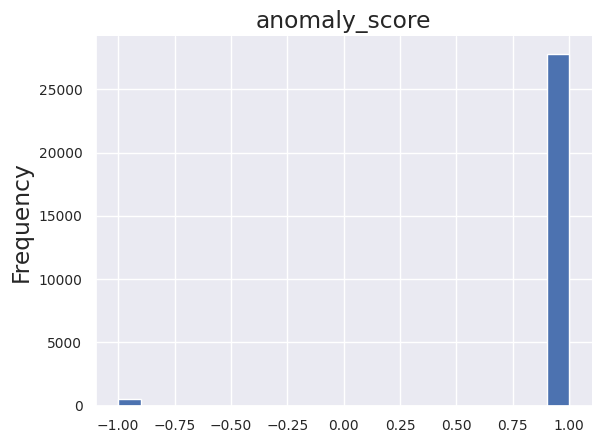

In [60]:
# anomaly_score
data['anomaly_score'].plot(kind='hist', bins=20, title='anomaly_score')
plt.gca().spines[['top', 'right',]].set_visible(False)

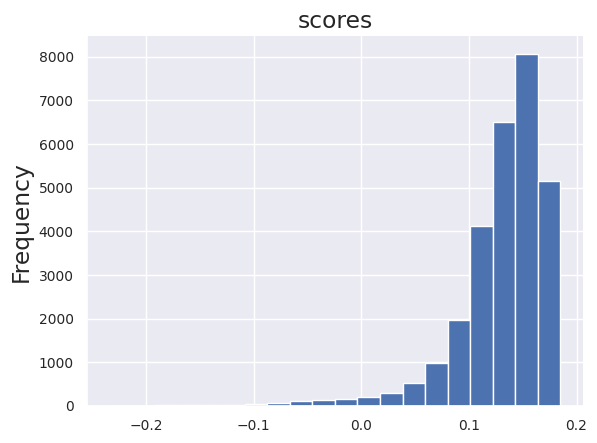

In [62]:
# scores
data['scores'].plot(kind='hist', bins=20, title='scores')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [65]:
# setting threshold of score
# if score > threshold, normal; else, outlier
threshold = 0.1
data_normal = data.iloc[np.where(data.anomaly_score.to_numpy() > threshold)]
data_outlier = data.iloc[np.where(data.anomaly_score < threshold)]

In [ ]:
normal_data.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,scores,anomaly_score,result
121884,76355.0,1.177195,0.354835,-0.050112,0.996283,0.114707,-0.533672,0.323340,-0.039656,-0.440988,0.192541,1.610483,0.652893,-0.903942,0.952140,0.301903,-0.336806,-0.167604,-0.297136,-0.393193,-0.232363,0.086546,0.269000,-0.093402,0.224293,0.697098,-0.294187,0.000146,-0.002305,1.00,0.174349,1,0
150951,94213.0,1.929328,-0.230009,-0.722492,1.379370,0.327867,0.869605,-0.459958,0.156941,2.348205,-0.219169,0.097356,-1.709852,1.224763,1.365096,-2.463741,0.103727,0.011052,0.293584,0.738815,-0.256200,-0.695468,-1.555905,0.254467,-1.599841,-0.225790,-1.074505,0.018082,-0.057300,34.99,0.083735,1,0
8235,11058.0,1.245603,-0.063529,0.856232,0.336334,-0.916074,-0.863592,-0.496453,-0.153100,1.872207,-0.493736,0.490502,-2.842432,0.893779,1.653561,0.677589,0.528428,0.346374,0.264330,-0.397987,-0.138715,-0.076642,-0.003412,-0.004729,0.377923,0.176246,1.034232,-0.095239,0.003889,15.95,0.130931,1,0
211010,138219.0,-0.939001,1.082314,-0.267542,-1.106319,1.011555,-1.012780,1.054262,-0.143406,0.018528,-0.512210,-1.541309,0.196441,0.462485,0.222478,-0.334665,-0.321991,-0.525759,-0.403170,0.374998,-0.093108,-0.129332,-0.169412,-0.395748,-0.618097,-0.057835,-0.134543,-0.143480,-0.164164,0.01,0.166577,1,0
246098,153033.0,-1.340880,0.364304,1.265265,-0.479915,-0.849015,0.489150,0.766527,0.619257,-0.378495,-1.226591,0.279870,0.171774,-0.736429,0.663261,0.448371,0.557524,-0.610001,0.893902,0.644026,0.334137,0.060539,-0.415840,0.275328,-0.553855,0.380016,-0.401064,-0.136261,0.012904,231.12,0.153861,1,0


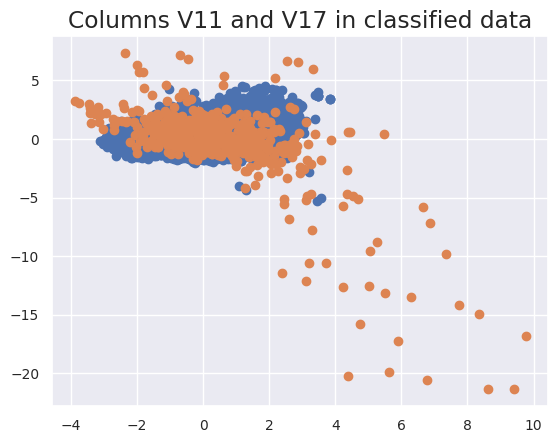

In [69]:
# Scatter plot of column `V11` and `V17`
# , which shows correlation with `Class` in correlation plot above
# in classfied data
plt.scatter(data_normal['V11'], data_normal['V17'])
plt.scatter(data_outlier['V11'], data_outlier['V17'])
plt.title("Columns V11 and V17 in classified data")
plt.show()

## Evaluating the model

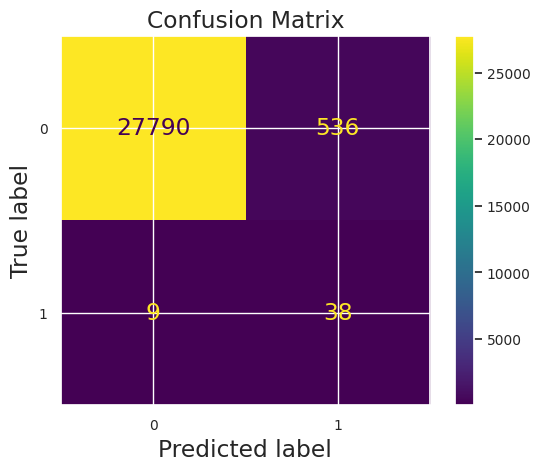

In [71]:
ConfusionMatrixDisplay.from_predictions(y_test , y_pred_binary)
plt.title("Confusion Matrix")
plt.show()

In [72]:
print("\nClassification Report:\n")
print(Fore.BLUE + classification_report(y_test, y_pred_binary))
precision, recall, _ = precision_recall_curve(y_test, y_pred_binary)
auprc = auc(recall, precision)
auc = roc_auc_score(y_test , y_pred_binary)
print("auc:", auc)
print("AUPRC:", auprc)


Classification Report:

              precision    recall  f1-score   support

           0       1.00      0.98      0.99     28326
           1       0.07      0.81      0.12        47

    accuracy                           0.98     28373
   macro avg       0.53      0.89      0.56     28373
weighted avg       1.00      0.98      0.99     28373

auc: 0.8947940468196274
AUPRC: 0.43751496593243283


## Plot ROC curve

In [73]:
# Plot roc curve and compute area under the curve

def plot_roc_curve(fpr, tpr, label=None):

    plt.plot(fpr, tpr, linewidth = 2, label= 'auc= '+ str(label))
    plt.plot([0, 1], [0, 1], "k--")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate(Recall)")
    plt.title("ROC Curve")
    plt.axis([0, 1, 0, 1])
    plt.legend(loc=4)
    plt.show()

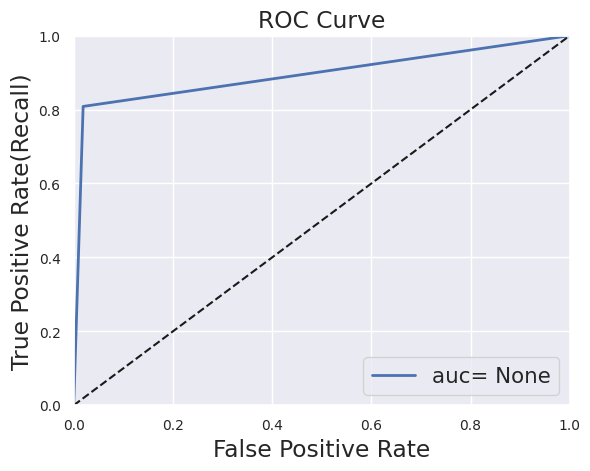

In [74]:
# roc curve
fpr, tpr, _ = metrics.roc_curve(y_test, y_pred_binary)
plot_roc_curve(fpr, tpr, label=None)

# Reference
- [Anomaly detection using isolation forest a complete guide](https://www.analyticsvidhya.com/blog/2021/07/anomaly-detection-using-isolation-forest-a-complete-guide/)
- [documentation of sklearn.ensemble.IsolationForest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html)
- [Kaggle dataset - Credit Card Fraud Detection](https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud)
- [Kaggle notebook - credit card fraud detection (isolated forest)](https://www.kaggle.com/code/abdoghazala/credit-card-fraud-detection-isolationforest)
- [Kaggle notebook - anomaly detection using isolation forest](https://www.kaggle.com/code/tanvikurade/anomaly-detection-using-isolation-forest)
- [S. Hariri, M. C. Kind and R. J. Brunner, "Extended Isolation Forest," in IEEE Transactions on Knowledge and Data Engineering, vol. 33, no. 4, pp. 1479-1489, 1 April 2021, doi: 10.1109/TKDE.2019.2947676](https://ieeexplore.ieee.org/abstract/document/8888179)


